## United Kingdom Road traffic accidents analysis_2020

We'll go stepwise to create a report that covers the following questions:

1. What time of day and day of the week do most serious accidents happen?
2. Are there any patterns in the time of day/ day of the week when serious accidents occur?
3. What characteristics stand out in serious accidents compared with other accidents?
4. On what areas would you recommend the planning team focus their brainstorming efforts to reduce serious accidents?

## 💾 The data
The reporting department have been collecting data on every accident that is reported. They've included this along with a lookup file for 2020's accidents.

*Published by the department for transport. https://data.gov.uk/dataset/road-accidents-safety-data* 
*Contains public sector information licensed under the Open Government Licence v3.0.*

## First : Check out and discover the provided data.
The first process should be taken in account in order to understand the nature of the data, and to ease answer all the asked questions.

In [1]:
%%capture
!pip install folium

In [2]:
# import requierd libraries and modules

import numpy as np
import pandas as pd
import calendar
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')
import seaborn as sns
import folium
from folium.plugins import HeatMap
from folium import plugins
from folium.plugins import MarkerCluster
from folium.plugins import HeatMapWithTime

In [4]:
# read the data and present the first five rows.

accidents = pd.read_csv('D:/DataCamp/Competitions_data/competition_2/accident-data.csv')
accidents.head()

,accident_index,accident_year,accident_reference,longitude,latitude,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,...,second_road_class,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area
0,2020010219808,2020,10219808,-0.254001,51.462262,3,1,1,04/02/2020,3,...,6,0,9,9,1,9,9,0,0,1
1,2020010220496,2020,10220496,-0.139253,51.470327,3,1,2,27/04/2020,2,...,6,0,0,4,1,1,1,0,0,1
2,2020010228005,2020,10228005,-0.178719,51.529614,3,1,1,01/01/2020,4,...,6,0,0,0,4,1,2,0,0,1
3,2020010228006,2020,10228006,-0.001683,51.541210,2,1,1,01/01/2020,4,...,6,0,0,4,4,1,1,0,0,1
4,2020010228011,2020,10228011,-0.137592,51.515704,3,1,2,01/01/2020,4,...,5,0,0,0,4,1,1,0,0,1


In [5]:
# Read the look up table related to the main data

lookup = pd.read_csv('D:/DataCamp/Competitions_data/competition_2/road-safety-lookups.csv')
lookup.head()

,table,field name,code/format,label,note
0,Accident,accident_index,NaN,NaN,unique value for each accident. The accident_i...
1,Accident,accident_year,NaN,NaN,NaN
2,Accident,accident_reference,NaN,NaN,In year id used by the police to reference a c...
3,Accident,longitude,NaN,NaN,Null if not known
4,Accident,Latitude,NaN,NaN,Null if not known


In [6]:
# shape of the data

print(accidents.shape)

(91199, 27)


In [7]:
# List of columns names

list(accidents.columns)

['accident_index',
 'accident_year',
 'accident_reference',
 'longitude',
 'latitude',
 'accident_severity',
 'number_of_vehicles',
 'number_of_casualties',
 'date',
 'day_of_week',
 'time',
 'first_road_class',
 'first_road_number',
 'road_type',
 'speed_limit',
 'junction_detail',
 'junction_control',
 'second_road_class',
 'second_road_number',
 'pedestrian_crossing_human_control',
 'pedestrian_crossing_physical_facilities',
 'light_conditions',
 'weather_conditions',
 'road_surface_conditions',
 'special_conditions_at_site',
 'carriageway_hazards',
 'urban_or_rural_area']

In [8]:
# check out the data info

accidents.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91199 entries, 0 to 91198
Data columns (total 27 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   accident_index                           91199 non-null  object 
 1   accident_year                            91199 non-null  int64  
 2   accident_reference                       91199 non-null  object 
 3   longitude                                91185 non-null  float64
 4   latitude                                 91185 non-null  float64
 5   accident_severity                        91199 non-null  int64  
 6   number_of_vehicles                       91199 non-null  int64  
 7   number_of_casualties                     91199 non-null  int64  
 8   date                                     91199 non-null  object 
 9   day_of_week                              91199 non-null  int64  
 10  time                                     91199

In [9]:
# check for missing data

NAN = accidents.isnull().sum()
NAN


accident_index                              0
accident_year                               0
accident_reference                          0
longitude                                  14
latitude                                   14
accident_severity                           0
number_of_vehicles                          0
number_of_casualties                        0
date                                        0
day_of_week                                 0
time                                        0
first_road_class                            0
first_road_number                           0
road_type                                   0
speed_limit                                 0
junction_detail                             0
junction_control                            0
second_road_class                           0
second_road_number                          0
pedestrian_crossing_human_control           0
pedestrian_crossing_physical_facilities     0
light_conditions                  

--------------------
--------------------
## Second : Answer the first and second questions
## 1. What time of day and day of the week do most serious accidents happen?
## 2. Are there any patterns in the time of day/ day of the week when serious accidents occur?

To acheive this gool, we ought to focus on the date and time available columns within the data, as we found out from the previous checking 
of data, that we have four columns related to the date and time, to reach out the time of the day, and also the day of the week of most
serious accidents we'll discover these columns in more details.

In [10]:
# check out the date and time columns

date_time = accidents[['date', 'accident_year', 'day_of_week', 'time']]
date_time.info()
print(date_time.head(5))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91199 entries, 0 to 91198
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   date           91199 non-null  object
 1   accident_year  91199 non-null  int64 
 2   day_of_week    91199 non-null  int64 
 3   time           91199 non-null  object
dtypes: int64(2), object(2)
memory usage: 2.8+ MB
         date  accident_year  day_of_week   time
0  04/02/2020           2020            3  09:00
1  27/04/2020           2020            2  13:55
2  01/01/2020           2020            4  01:25
3  01/01/2020           2020            4  01:50
4  01/01/2020           2020            4  02:25


------------------------
------------------------

Merge the columns date and time, into to one new column called <b>"dates_time"</b>, and convert it from object into to dataframe datetime
These two columns have been selected, because the first one date represents the month and day as well as year, the second one the time
represents the time of the day in which the accident has occured.

In [11]:
# convert the new dates_time column from object into to dataframe datetime

accidents['dates_time'] = pd.to_datetime(accidents['date'] + ' ' + accidents['time'])

# check out the type of the new created column dates_time

accidents.dates_time.dtype

dtype('<M8[ns]')

In [12]:
# Check out the head of the new dataset

accidents.head(5)

,accident_index,accident_year,accident_reference,longitude,latitude,accident_severity,number_of_vehicles,number_of_casualties,date,day_of_week,...,second_road_number,pedestrian_crossing_human_control,pedestrian_crossing_physical_facilities,light_conditions,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,dates_time
0,2020010219808,2020,10219808,-0.254001,51.462262,3,1,1,04/02/2020,3,...,0,9,9,1,9,9,0,0,1,2020-04-02 09:00:00
1,2020010220496,2020,10220496,-0.139253,51.470327,3,1,2,27/04/2020,2,...,0,0,4,1,1,1,0,0,1,2020-04-27 13:55:00
2,2020010228005,2020,10228005,-0.178719,51.529614,3,1,1,01/01/2020,4,...,0,0,0,4,1,2,0,0,1,2020-01-01 01:25:00
3,2020010228006,2020,10228006,-0.001683,51.541210,2,1,1,01/01/2020,4,...,0,0,4,4,1,1,0,0,1,2020-01-01 01:50:00
4,2020010228011,2020,10228011,-0.137592,51.515704,3,1,2,01/01/2020,4,...,0,0,0,4,1,1,0,0,1,2020-01-01 02:25:00


In [13]:
# Assess whether or not the dataframe contains duplicated rows.

accidents.duplicated().sum()

0

In [14]:
# Drop columns hour, day, month, year, weekday

accidents.drop(['time','date','day_of_week'], axis=1, inplace=True)

# Dataframe columns
list(accidents.columns)

['accident_index',
 'accident_year',
 'accident_reference',
 'longitude',
 'latitude',
 'accident_severity',
 'number_of_vehicles',
 'number_of_casualties',
 'first_road_class',
 'first_road_number',
 'road_type',
 'speed_limit',
 'junction_detail',
 'junction_control',
 'second_road_class',
 'second_road_number',
 'pedestrian_crossing_human_control',
 'pedestrian_crossing_physical_facilities',
 'light_conditions',
 'weather_conditions',
 'road_surface_conditions',
 'special_conditions_at_site',
 'carriageway_hazards',
 'urban_or_rural_area',
 'dates_time']

-----------------------
----------------------

Now as we can see in the following, it's very easy to extract different types of date from the column  <b>dates_time</b> 

In [15]:
# Extract the year

accidents['dates_time'].dt.year

# Extract the month

accidents['dates_time'].dt.month

# Extract the day

accidents['dates_time'].dt.day

# Extract the hours

accidents['dates_time'].dt.hour

# Extract the day of the week

print('Days of Week as an example of extracting all type of dates:\n',accidents['dates_time'].dt.dayofweek)

Days of Week as an example of extracting all type of dates:
 0        3
1        0
2        2
3        2
4        2
        ..
91194    1
91195    4
91196    2
91197    1
91198    1
Name: dates_time, Length: 91199, dtype: int64


In [16]:
# Day of the week - first five elements of the returned serie

accidents['dates_time'].dt.dayofweek.head()

0    3
1    0
2    2
3    2
4    2
Name: dates_time, dtype: int64

------------
------------

Now we're able to find out the total number of accidents have happened in 2020.

In [17]:
# Total number of accidents in 2020

print('Total number of accidents in 2020 are : {}'.format(accidents.shape[0]))

Total number of accidents in 2020 are : 91199


---------------
---------------

We're also able to find out the total number of accidents have happened in each month from January to December, 2020, and plot them.

In [18]:
# Number of accident per month
accidents_month = accidents.groupby(accidents['dates_time'].dt.month).count().dates_time

# Replace the month integers by month names.
accidents_month.index = [calendar.month_name[x] for x in range(1,13)]

accidents_month

January      9392
February     7911
March        5968
April        5308
May          6851
June         7521
July         8134
August       8161
September    8761
October      8431
November     7431
December     7330
Name: dates_time, dtype: int64

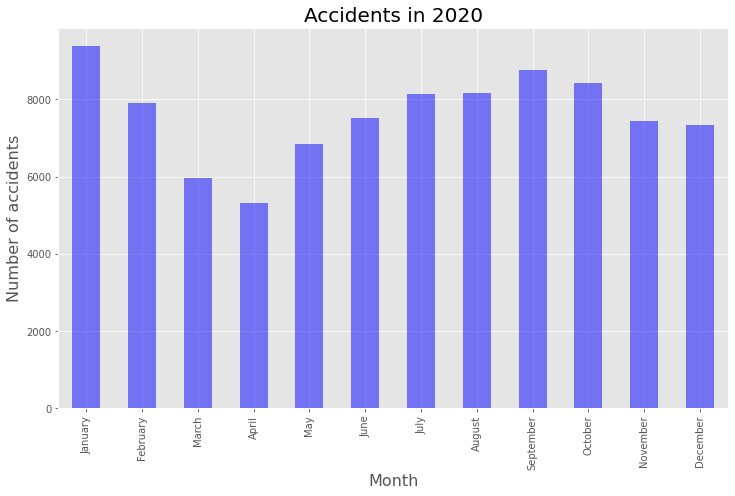

In [23]:
# plot accidents per month

accidents_month.plot(kind='bar',figsize=(12,7), color='blue', alpha=0.5)

# title and x,y labels

plt.title('Accidents in 2020', fontsize=20)
plt.xlabel('Month',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

------------------
-----------------

Furthermore we're able to figure out the total number of accidents have happened in each day from Monday to Sunday, in 2020, and plot them.

In [19]:
# Number of accident per day 

accidents_day = accidents.groupby(accidents['dates_time'].dt.dayofweek).count().dates_time

# Replace the month integers by month names.
accidents_day.index = [calendar.day_name[x] for x in range(0, 7)]

accidents_day

Monday       12856
Tuesday      12947
Wednesday    13541
Thursday     14222
Friday       13912
Saturday     12250
Sunday       11471
Name: dates_time, dtype: int64

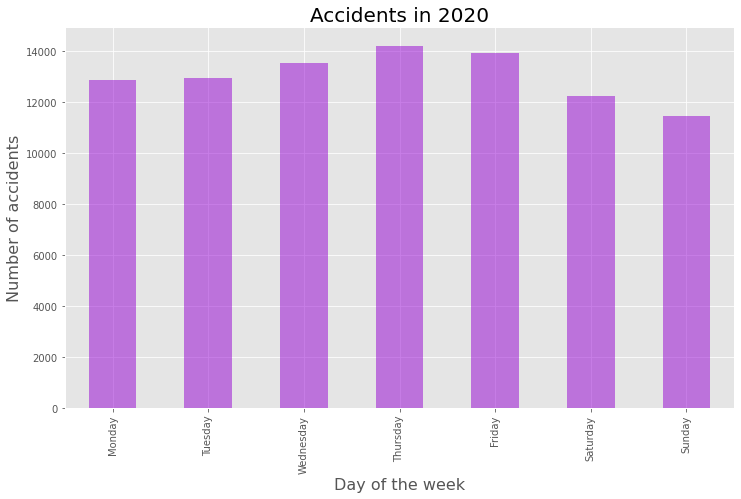

In [25]:
# Number of accident per day 

accidents_day = accidents.groupby(accidents['dates_time'].dt.dayofweek).count().dates_time

# Replace the month integers by month names.
accidents_day.index = [calendar.day_name[x] for x in range(0, 7)]


# plot accidents per day
accidents_day.plot(kind='bar',figsize=(12,7), color='darkviolet', alpha=0.5)

# title and x,y labels
plt.title('Accidents in 2020', fontsize=20)
plt.xlabel('Day of the week',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

From the previous figure it's very obvious that the highest number of accidents are occuring during Thursday and Friday, we can figure out this issue more by ploting the accidents of these two days.

-------------------
-------------------

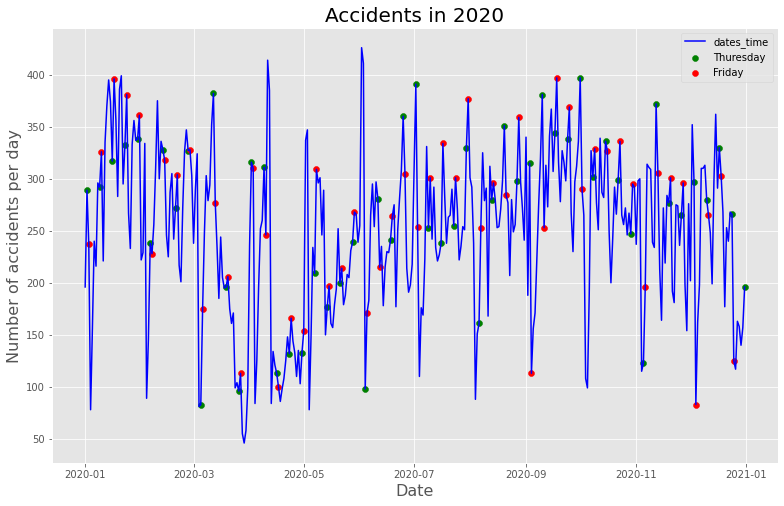

In [20]:
accident_Fri_Sun = accidents.groupby(accidents['dates_time'].dt.date).count().dates_time
accident_Fri_Sun.plot(figsize=(13,8), color='blue')
# sunday accidents
Thuresday = accidents.groupby(accidents[accidents['dates_time'].dt.dayofweek==3].dates_time.dt.date).count().dates_time
plt.scatter(Thuresday.index, Thuresday, color='green', label='Thuresday')

# friday accidents
Friday = accidents.groupby(accidents[accidents['dates_time'].dt.dayofweek==4].dates_time.dt.date).count().dates_time

plt.scatter(Friday.index, Friday, color='red', label='Friday')

# Title, x label and y label
plt.title('Accidents in 2020', fontsize=20)
plt.xlabel('Date',fontsize=16)
plt.ylabel('Number of accidents per day',fontsize=16);
plt.legend()

It's very clear that the number of accidents on Thursdays, and Fridays occupy the first place during the year 2020.

-----------------
------------------

Following is the correlation plot between total number of accidents have happened in each hour of the daye, in 2020.

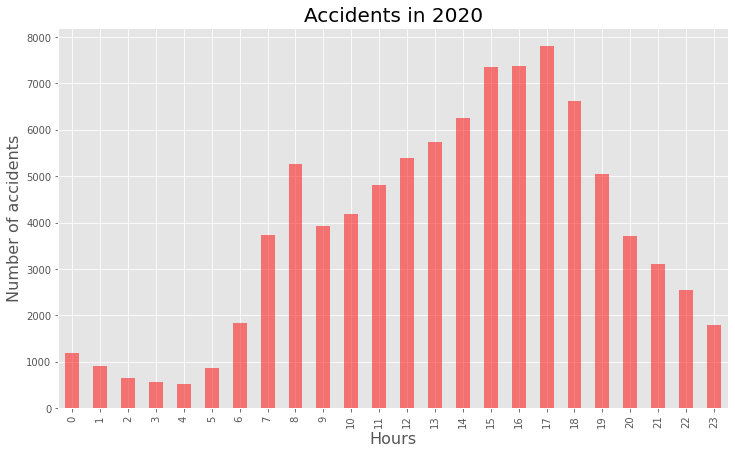

In [21]:
# Number of accident per hour

accidents_hour = accidents.groupby(accidents['dates_time'].dt.hour).count().dates_time

# plot accidents per hour
accidents_hour.plot(kind='bar',figsize=(12,7), color='red', alpha=0.5)

# title and x,y labels
plt.title('Accidents in 2020', fontsize=20)
plt.xlabel('Hours',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

It's very obvious that the accidents number start to increase from the first rush traffic hour of the day at 06:00 O'clock, and contiune increasing until the last rush hour of the day at 17:00 evening, later on starting to decrease again, until 23:00.

------------------
-------------------

In order to answer the other part of the question one, we'll take a look at the lookup tabel, and figure out the type of accident severity.

In [22]:
# Explore the accident severity type from the lookup tabel

lookup[lookup['field name']=='accident_severity'].head()

,table,field name,code/format,label,note
5,Accident,accident_severity,1,Fatal,NaN
6,Accident,accident_severity,2,Serious,NaN
7,Accident,accident_severity,3,Slight,NaN


---------------------
---------------------

Now we can answer the other part of the question 1, In What time of the day, and of the week the seriuos accidents have occured.

We have three types of accidents' severity, according the above lookup tabel

accident severity == 1, which it's equal to Fatal.
accident severity == 2 , Serious.
accident severity ==3, Slight.



In [23]:
accident_severity_type_name={
    
    1: 'Fatal',
    2: 'Serious',
    3: 'Slight'
}
    

# replace the numbers of representative raods with full name

accidents.replace({"accident_severity": accident_severity_type_name}, inplace=True)

In [24]:
# Slice the accident severity equal to 1 Fatal, and create a new column called FATAL

accidents['FATAL'] = accidents['accident_severity']=='Fatal'

# Slice the accident severity equal to 2 serious, and create a new column called Serious

accidents['Serious'] = accidents['accident_severity']=='Serious'

# Slice the accident severity equal to 3 slight, and create a new column called Slight
accidents['Slight'] = accidents['accident_severity']=='Slight'

Text(0, 0.5, '')

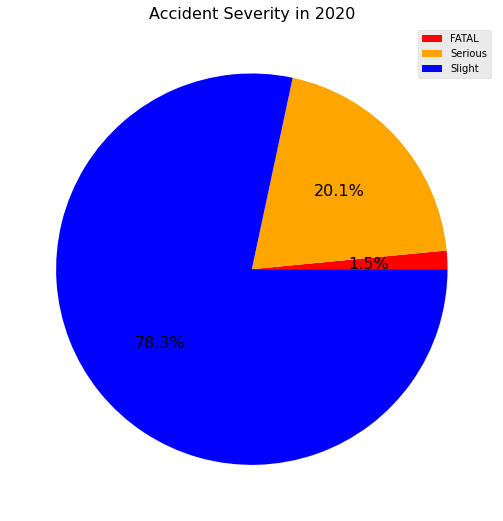

In [31]:
# Series with number of accident severity 1, 2 and 3

severity = accidents[['FATAL','Serious', 'Slight']].sum()

# Pie plot with the percentage of severity 2, and 3

severity.plot(kind='pie',figsize=(9, 9), colors=['red','orange', 'blue'], labels=None, autopct='%1.1f%%', fontsize=16)

# Legend and title
plt.legend(labels=['FATAL', 'Serious', 'Slight'])
plt.title('Accident Severity in 2020', fontsize=16)
plt.ylabel('')

Accident severity equal to fatal, constitutes 1.5%, and serious accidents, 20.1%, While the Slight forms the highest ratio which is, 78.3%.

--------------------------
-------------------------

In [25]:
# Number of accident severity Fatal per day of the week

fatal = accidents[accidents['FATAL']].groupby(accidents['dates_time'].dt.dayofweek).sum().FATAL

# Percentage of serious injuries per day of the week
rate_fatal = fatal/fatal.sum()

# Number of accident severity Serious per day of the week

serious = accidents[accidents['Serious']].groupby(accidents['dates_time'].dt.dayofweek).sum().Serious

# Percentage of mild injuries per day of the week
rate_serious = serious/serious.sum()

# Number of accident severity Slight per day of the week

slight = accidents[accidents['Slight']].groupby(accidents['dates_time'].dt.dayofweek).sum().Slight
# Percentage of mild injuries per day of the week
rate_slight = slight/slight.sum()

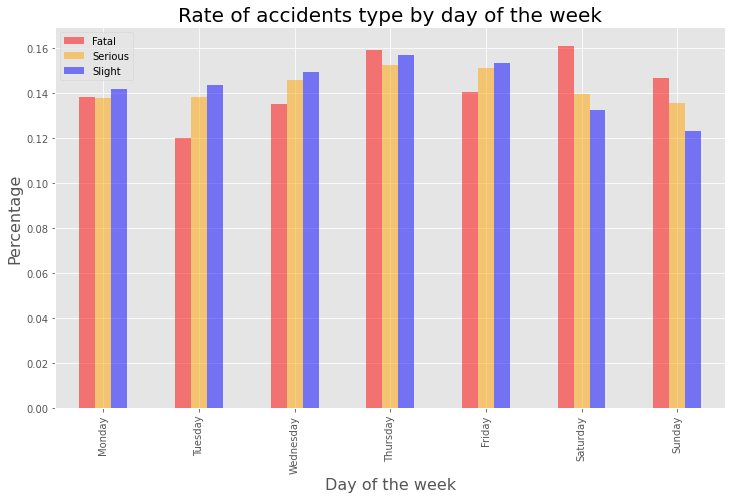

In [26]:
# Combine both series as a dataframe in order to plot them as a side by side bar
rates = pd.DataFrame({'Fatal': rate_fatal,'Serious': rate_serious, 'Slight': rate_slight})
rates.plot(kind='bar',figsize=(12,7),color=['red','orange', 'blue'],alpha=0.5)

# Title and labels
plt.title('Rate of accidents type by day of the week',fontsize=20)
plt.xlabel('Day of the week',fontsize=16)
plt.ylabel('Percentage',fontsize=16)
plt.xticks(np.arange(7),[calendar.day_name[x] for x in range(0,7)]);

In [27]:
# Number of accident severity Fatal per hour of the day

fatal = accidents[accidents['FATAL']].groupby(accidents['dates_time'].dt.hour).sum().FATAL

# Percentage of serious injuries per day of the week
rate_fatal = fatal/fatal.sum()

# Number of accident severity Serious per hour of the day

serious = accidents[accidents['Serious']].groupby(accidents['dates_time'].dt.hour).sum().Serious

# Percentage of mild injuries per day of the week
rate_serious = serious/serious.sum()

# Number of accident severity Slight per hour of the day

slight = accidents[accidents['Slight']].groupby(accidents['dates_time'].dt.hour).sum().Slight
# Percentage of mild injuries per day of the week
rate_slight = slight/slight.sum()

Text(0, 0.5, 'Percentage')

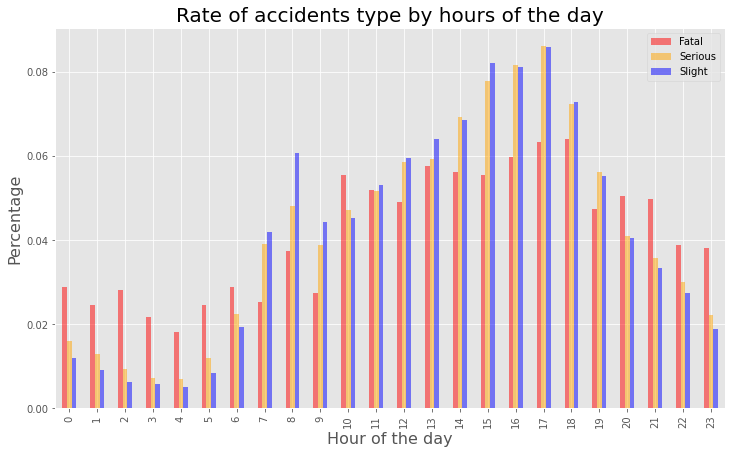

In [28]:
# Combine both series as a dataframe in order to plot them as a side by side bar
rates = pd.DataFrame({'Fatal': rate_fatal,'Serious': rate_serious, 'Slight': rate_slight})
rates.plot(kind='bar',figsize=(12,7),color=['red','orange', 'blue'],alpha=0.5)

# Title and labels
plt.title('Rate of accidents type by hours of the day',fontsize=20)
plt.xlabel('Hour of the day',fontsize=16)
plt.ylabel('Percentage',fontsize=16)

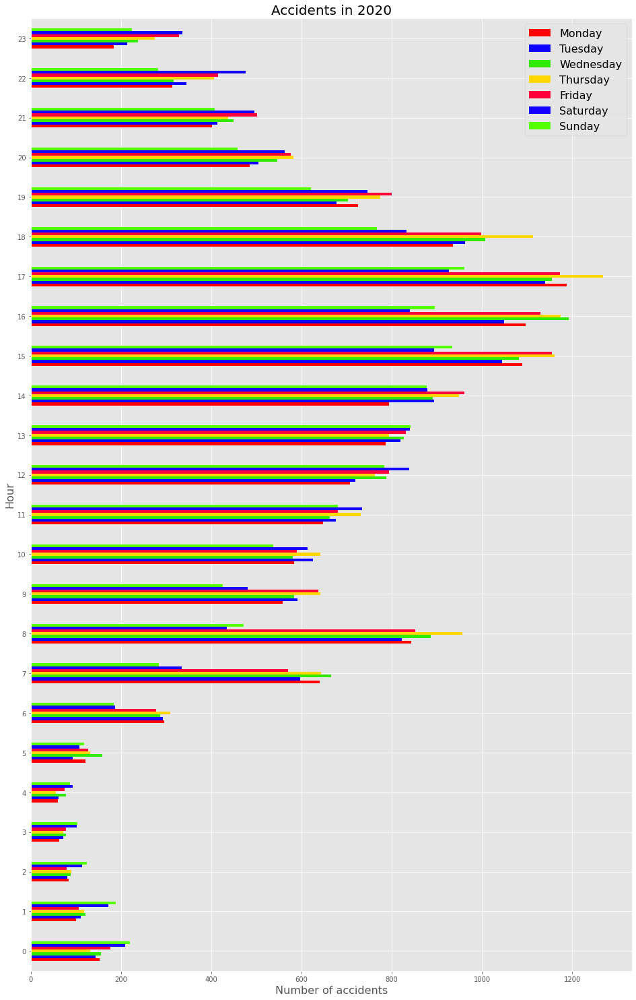

In [29]:
# Number of accident per hour and day
accidents_hour_day = accidents.groupby([accidents['dates_time'].dt.hour.rename('hour'),
                                        accidents['dates_time'].dt.dayofweek.rename('day')]).count().dates_time

accidents_hour_day.unstack().plot(kind='barh', figsize=(16,26), colormap='prism')

# title and x,y labels
plt.legend(labels=[calendar.day_name[x] for x in range(0,7)],fontsize=16)
plt.title('Accidents in 2020',fontsize=20)
plt.xlabel('Number of accidents',fontsize=16)
plt.ylabel('Hour',fontsize=16);

-----------------------
----------------------

<b> The First Conculsion of analysis the time of day and day of the week do most serious accidents happen, and explain patterns in the time of day and the week when serious accidents occur </b>, 

The analysis of data refers to the followoing, 

A. The highest number of accidents are on the days Thursday and Friday/per 2020, since the number of all accidents severity has acceeded 12000 cases of the two days respectively.

B. By dividing the severity of accidents into to three types, Fatal, Serious, and slight, we found that the highest rate of accidents are on the days Thursday and Friday/per 2020, since the rate of all accidents severity has acceeded 0.14 of the two days respectively, furthermore the fatal on Saturday has registered the highest rate 0.16.

C. The rate of hourly accidents per day starts to increase from the rush hours at 07:00 morning until 17 evening, 
with regards to slight accidents severity starts to increase from the 06:00 morning until 08:00 then decreases at 09:00 O'clock, thens starts to increase once more until the 17:00. 

D. It's noteble that the slight, and serious accidents have the highes rate between the hours 15:00 - 17:00.

C. All the type of accidents form normal disteribution shape from 06:00 - 23:00. 


---------------
-------------------

<b> Third: Answer the third question</b>
## 3. What characteristics stand out in serious accidents compared with other accidents?

In order to answer this question we must take a look once more at our data to find out what other columns to include in this analysis.

In [30]:
# List the columns of data

list(accidents.columns)

['accident_index',
 'accident_year',
 'accident_reference',
 'longitude',
 'latitude',
 'accident_severity',
 'number_of_vehicles',
 'number_of_casualties',
 'first_road_class',
 'first_road_number',
 'road_type',
 'speed_limit',
 'junction_detail',
 'junction_control',
 'second_road_class',
 'second_road_number',
 'pedestrian_crossing_human_control',
 'pedestrian_crossing_physical_facilities',
 'light_conditions',
 'weather_conditions',
 'road_surface_conditions',
 'special_conditions_at_site',
 'carriageway_hazards',
 'urban_or_rural_area',
 'dates_time',
 'FATAL',
 'Serious',
 'Slight']

In [31]:
# Explore the urban_or_rural_area type from the lookup tabel

lookup[lookup['field name']=='urban_or_rural_area'].head()

,table,field name,code/format,label,note
125,Accident,urban_or_rural_area,1,Urban,field introduced in 1994
126,Accident,urban_or_rural_area,2,Rural,field introduced in 1994
127,Accident,urban_or_rural_area,3,Unallocated,field introduced in 1994
128,Accident,urban_or_rural_area,-1,Data missing or out of range,field introduced in 1994


-------------------
-------------------

The road_type column is represented by numbers, in order to get the road name, the first step is to convert road_type column from the representative numbers into to real names, by taking them from the look_up_table

In [32]:
# Take a look at the road_type

accidents.road_type.head()

0    6
1    6
2    6
3    6
4    6
Name: road_type, dtype: int64

In [33]:
road_type_name={
    
    1: 'Roundabout',
    2: 'One way street',
    3: 'Dual carriageway',
    6: 'Single carriageway',
    7: 'Slip road',
    9: 'Unknown',
    12: 'One way street/Slip road',
    -1: 'Data missing or out of range'
}
    

# replace the numbers of representative raods with full name

accidents.replace({"road_type": road_type_name},inplace=True)

In [34]:
# Take a look at the road_type

accidents.road_type.head()

0    Single carriageway
1    Single carriageway
2    Single carriageway
3    Single carriageway
4    Single carriageway
Name: road_type, dtype: object

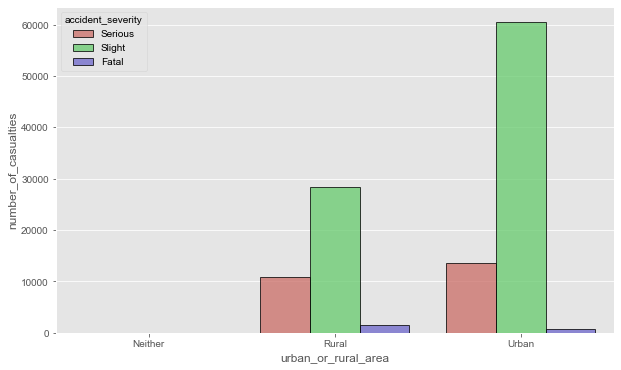

In [35]:
# Create Dataframe for Urban or Rural Area, Road Type and sum for Number of Casualties

area_road_type = accidents.groupby(['urban_or_rural_area',
                                     'road_type',
                                    'accident_severity']).sum()['number_of_casualties'].to_frame().reset_index()

# Convert Urban or Rural Area (1 or 2) raw data for respective area
area_road_type['urban_or_rural_area'] = [str('Urban') if value==1 else str('Rural') if value==2 else str('Neither') 
                                         for value in area_road_type['urban_or_rural_area']]

area_type = area_road_type.groupby(['urban_or_rural_area', 
                                    'accident_severity']).sum()['number_of_casualties'].to_frame().reset_index()

total_casualties = area_type['number_of_casualties'].sum()

road_type = area_road_type.groupby(['urban_or_rural_area', 
                                    'road_type']).sum()['number_of_casualties'].to_frame().reset_index()


urban_road = road_type.loc[road_type['urban_or_rural_area']=='Urban',:].sort_values('number_of_casualties', 
                                                                                    ascending=False)

rural_road = road_type.loc[road_type['urban_or_rural_area']=='Rural',:].sort_values('number_of_casualties', 
                                                                                    ascending=False)

plt.figure(figsize=(10,6))

g = sns.barplot(x='urban_or_rural_area', y='number_of_casualties', hue='accident_severity', data=area_type, 
                palette=sns.color_palette("hls", 3), linewidth=1, edgecolor='black', alpha=0.75)
sns.set_style('darkgrid')

It's very clear from the above figure that the type area affects the number of casualties, as well as the accident severity, Since, number of casualties in slight,a and serious types' accidents are occuring more in Urban area respectively comparing to the Rural area. However the fatal accidents are slightly more in Rural area.

-----------------------
-----------------------

Let's take a look at <b> Road Type <b/> In more details:

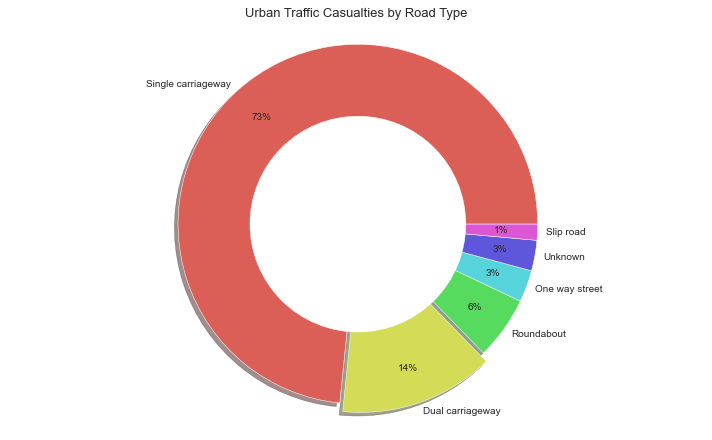

In [36]:
# Plot donuts for % of Casualties by Road Type for Urban and Rural
# Plot Urban donut
explode = (0.0,0.05,0.0,0.0,0.0, 0.0)
plt.figure(figsize=(10,6))

plt.pie(urban_road['number_of_casualties'], explode=explode, labels=urban_road['road_type'], counterclock=True,
        labeldistance=1.05, autopct='%.0f%%', pctdistance=0.8, shadow=True, colors=sns.color_palette("hls", 6))

# Draw circle
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
# Equal aspect ratio ensures that pie is drawn as a circle
plt.axis('equal')  
plt.tight_layout()

plt.title('Urban Traffic Casualties by Road Type', fontsize=13)
plt.show()

The above figure is depicted that the road type plays a significant role in number of casualties in Urban area.
Especially the single carriageway represents 73% of casualties number, and then the Dual carriageway with only 14%, However, the roundabout only 6%. 

-------------------
--------------------

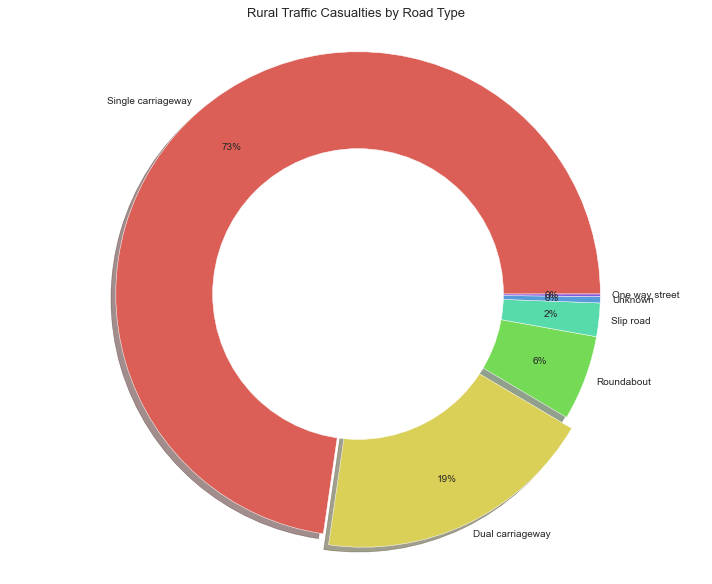

In [37]:
# Plot Rural donut
explode = (0.0,0.05,0.0,0.0,0.0, 0.0)
plt.figure(figsize=(10,8))

plt.pie(rural_road['number_of_casualties'], explode=explode, labels=rural_road['road_type'], counterclock=True,
        labeldistance=1.05, autopct='%.0f%%', pctdistance=0.8, shadow=True, colors=sns.color_palette("hls", 7))

# Draw circle
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Equal aspect ratio ensures that pie is drawn as a circle
plt.axis('equal')  
plt.tight_layout()

plt.title('Rural Traffic Casualties by Road Type', fontsize=13)

plt.show()

C:\Users\FALAH FAKHRI\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


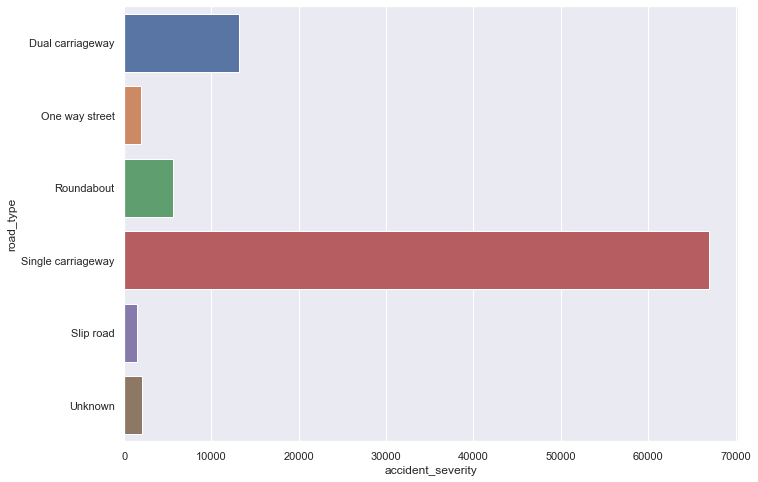

In [38]:
road_1 = accidents[['road_type', 'accident_severity']]

road_type_severity = road_1.groupby(by = 'road_type', as_index=False).count()
sns.set(rc={'figure.figsize':(11, 8)})
plt = sns.barplot(road_type_severity['accident_severity'],  road_type_severity['road_type'])
#pl.savefig('Images/Road Type and Severity Correlation')

In rural area, the  road type also plays a significant role in the number of casualties, since the number of casulties is more 5% in Dual Carriageway compering to the same road type in urban area.

<b> Let's take a look at another factor which is speed limit <b/> 

Text(17.246875000000003, 0.5, 'Speed Limit (km)')

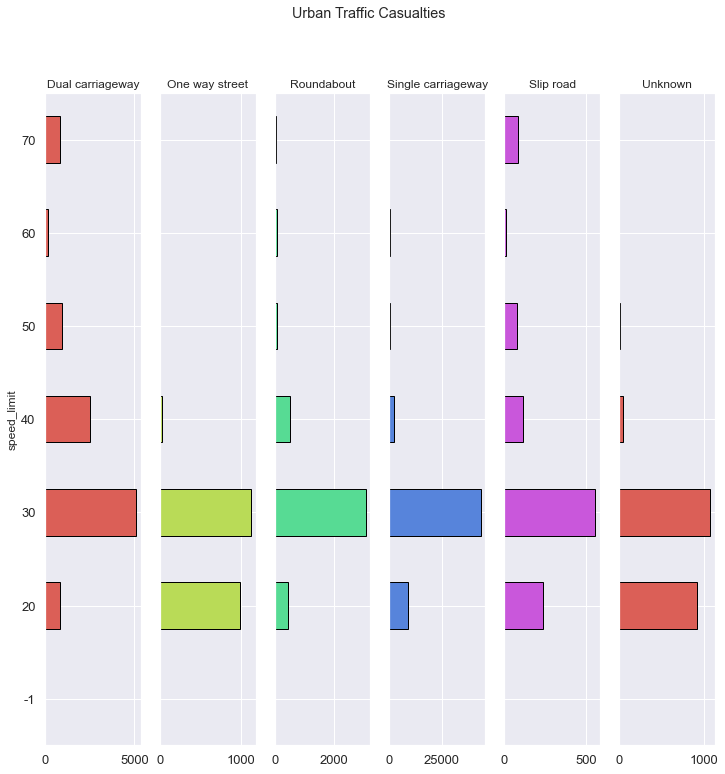

In [39]:
# Create dataframe grouped by Urban or Rural Area, Road Type, Speed Limit and sum for Number of Casualties
accidents_speed = accidents.groupby(['urban_or_rural_area', 
                                      'road_type',
                                      'speed_limit']).sum()['number_of_casualties'].to_frame().reset_index()

accidents_speed = accidents_speed.sort_values('number_of_casualties')

# Convert Urban or Rural Area (1 or 2) raw data for respective area
accidents_speed['urban_or_rural_area'] = [str('Urban') if value==1 else str('Rural') if value==2 else str('Neither') 
                                         for value in accidents_speed['urban_or_rural_area']]

# Create table for Urban traffic accidents and their speed limits and road types
urban_accidents_speed = accidents_speed.loc[accidents_speed['urban_or_rural_area']=='Urban',:]

urban_accidents_speed = urban_accidents_speed.pivot_table(values='number_of_casualties', 
                                                          index='speed_limit', 
                                                          columns='road_type', 
                                                          aggfunc=np.sum,
                                                          fill_value=0)
# Plot horizontal bar chart for Urban
urban_accidents_speed.plot(kind='barh', subplots=True, sharex=False, sharey=True,
                           title='Urban Traffic Casualties', legend=False, fontsize=13,
                           layout=(1,6), stacked=False, color=sns.color_palette("hls", 5), edgecolor='black',
                           figsize=(12,12))

plt.set_ylabel('Speed Limit (km)', fontsize=13)




Text(17.246875000000003, 0.5, 'Speed Limit (km)')

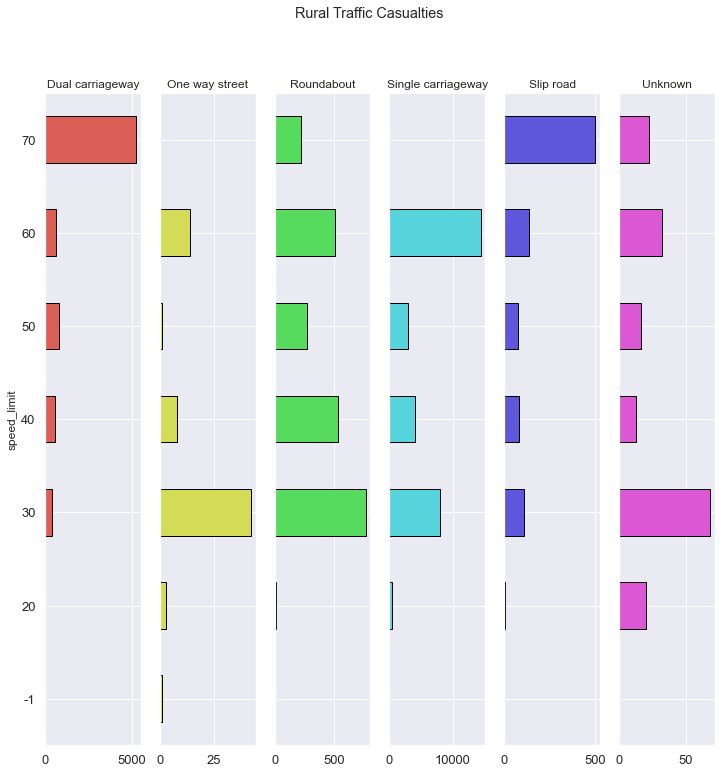

In [40]:
# Create table for Rural traffic accidents and their speed limits and road types

rural_accidents_speed = accidents_speed.loc[accidents_speed['urban_or_rural_area']=='Rural',:]

rural_accidents_speed = rural_accidents_speed.pivot_table(values='number_of_casualties', 
                                                          index='speed_limit', 
                                                          columns='road_type', 
                                                          aggfunc=np.sum,
                                                          fill_value=0)
# Plot horizontal bar chart for Rural
rural_accidents_speed.plot(kind='barh', subplots=True, sharex=False, sharey=True, 
                           title='Rural Traffic Casualties', legend=False, fontsize=13,
                           layout=(1,6), stacked=True, color=sns.color_palette("hls", 6), edgecolor='black',
                           figsize=(12,12))

plt.set_ylabel('Speed Limit (km)', fontsize=13)


The speed limits at the time of accidents were much lower in urban areas than in rural areas,  most traffic accidents occured at a speed limit of 30 kilometers per hour for urban araes, and and 30- 70 kilometers per hour for rural areas.

--------------------
-------------------

In [41]:
accidents.light_conditions.head()

0    1
1    1
2    4
3    4
4    4
Name: light_conditions, dtype: int64

In [42]:
# Explore the light conditions type from the lookup tabel

lookup[lookup['field name']=='light_conditions'].head(10)

,table,field name,code/format,label,note
80,Accident,light_conditions,1,Daylight,NaN
81,Accident,light_conditions,4,Darkness - lights lit,NaN
82,Accident,light_conditions,5,Darkness - lights unlit,NaN
83,Accident,light_conditions,6,Darkness - no lighting,NaN
84,Accident,light_conditions,7,Darkness - lighting unknown,NaN
85,Accident,light_conditions,-1,Data missing or out of range,NaN


In [43]:
light_type_name={
    
    1: 'Daylight',
    4: 'Darkness - lights lit',
    5: 'Darkness - lights unlit',
    6: 'Darkness - no lighting',
    7: 'Darkness - lighting unknown',
    -1: 'Data missing or out of range'
}
    

# replace the numbers of representative raods with full name

accidents.replace({"light_conditions": light_type_name},inplace=True)

C:\Users\FALAH FAKHRI\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


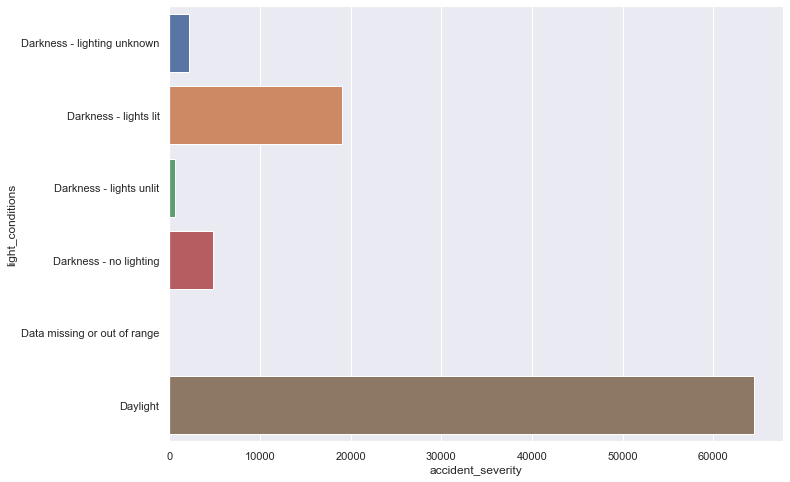

In [44]:
# Light Condition and Severity Correlation

grouper_light = accidents[['light_conditions', 'accident_severity']]

light_condition_severity = grouper_light.groupby(by = 'light_conditions',as_index=False).count()
sns.set(rc={'figure.figsize':(11, 8)})
plt = sns.barplot(light_condition_severity['accident_severity'], light_condition_severity['light_conditions'])

C:\Users\FALAH FAKHRI\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


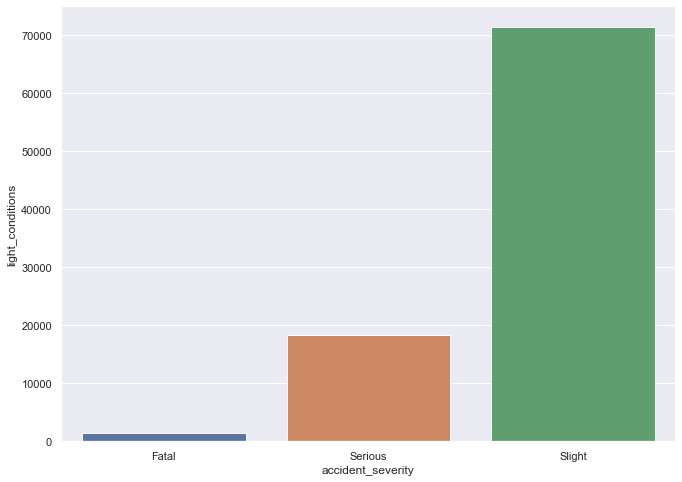

In [45]:
grouper_light_1 = accidents[['light_conditions', 'accident_severity']]
light_condition_severity_1 = grouper_light_1.groupby(by = 'accident_severity', as_index=False).count()
sns.set(rc={'figure.figsize':(11, 8)})
plt = sns.barplot(light_condition_severity_1['accident_severity'],light_condition_severity_1['light_conditions'])

<b>(Note, Highest means good and Lowest means bad.</b>)

The highest number of accident severity has happened in darkness lights unlit, followed by darkness no lighting, and darkness light lit. 

The bad light conditions affect very bad the slight, serious and fatal respectively.



In [46]:
# Explore the weather conditions type from the lookup tabel

lookup[lookup['field name']=='weather_conditions'].head(15)

,table,field name,code/format,label,note
86,Accident,weather_conditions,1,Fine no high winds,NaN
87,Accident,weather_conditions,2,Raining no high winds,NaN
88,Accident,weather_conditions,3,Snowing no high winds,NaN
89,Accident,weather_conditions,4,Fine + high winds,NaN
90,Accident,weather_conditions,5,Raining + high winds,NaN
91,Accident,weather_conditions,6,Snowing + high winds,NaN
92,Accident,weather_conditions,7,Fog or mist,NaN
93,Accident,weather_conditions,8,Other,NaN
94,Accident,weather_conditions,9,Unknown,NaN
95,Accident,weather_conditions,-1,Data missing or out of range,NaN


In [47]:
weather_type_name={
    
    1: 'Fine no high winds',
    2: 'Raining no high winds',
    3: 'Snowing no high winds',
    4: 'Fine + high winds',
    5: 'Raining + high winds',
    6: 'Snowing + high winds',
    7: 'Fog or mist', 
    8: 'Other', 
    9: 'Unkown', 
    -1: 'Data missing or out of range'
}
    

# replace the numbers of representative raods with full name

accidents.replace({"weather_conditions": weather_type_name},inplace=True)

C:\Users\FALAH FAKHRI\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


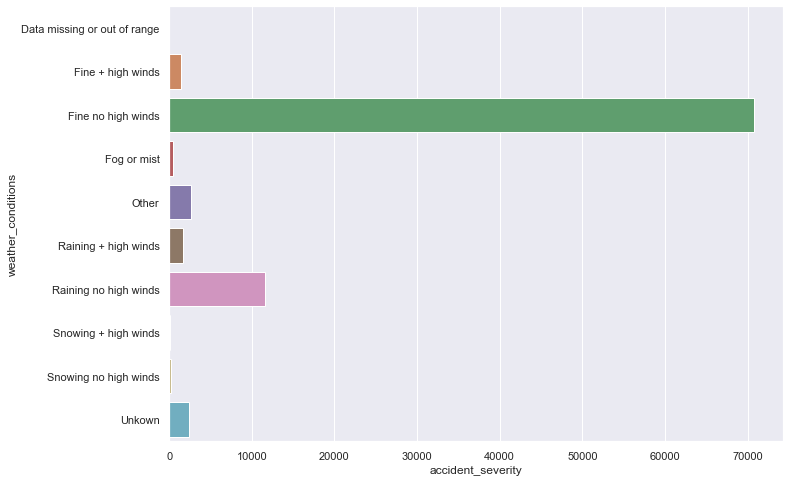

In [48]:
# Weather and Severity Correlation

weather_1 = accidents[['weather_conditions','accident_severity']]
weather_severity = weather_1.groupby(by = 'weather_conditions',as_index=False).count()
sns.set(rc={'figure.figsize':(11, 8)})
plt = sns.barplot(weather_severity['accident_severity'], weather_severity['weather_conditions'])


C:\Users\FALAH FAKHRI\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


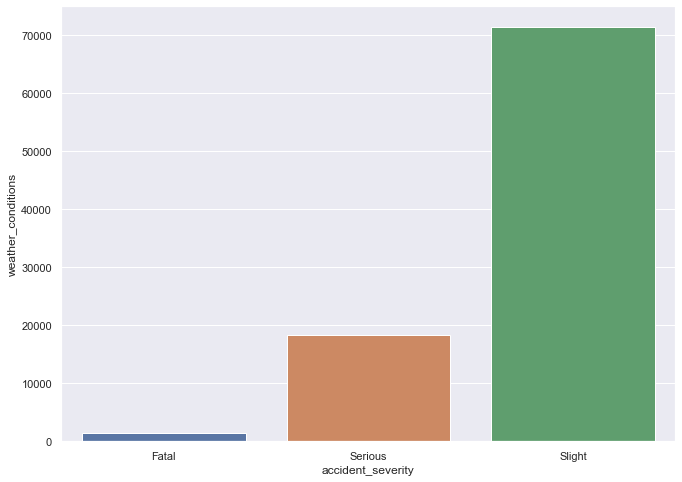

In [49]:

weather_1 = accidents[['weather_conditions','accident_severity']]
weather_severity_1 = weather_1.groupby(by = 'accident_severity',as_index=False).count()
plt1 = sns.barplot(weather_severity_1['accident_severity'], weather_severity_1['weather_conditions'])

#pl.savefig('Images/Severity and Weather Correlation.png'



The figures above shows that fog - mist, raining and high wind, snowing, are the most important factors are affecting the accident severity. 

The bad weather conditions affect very bad the slight, serious and fatal respectively.

--------------

-----------

<b>The second conclusion the characteristics stand out in serious accidents compared with other accidents</b>

The above correlations, and figures refer to different parameters are affecting the serious accidents.

A. Type of the road in rural area, and in urban area one of the parameters affect the number of accidents.

B. The bad weather conditions as accompany with road type and light conditions also play a significant role in different areas of increasing the number of accident and the type of accident from slight to fatal. 

--------------
------------------

<b> Fourth: Answer the fourth question</b>
## 4. On what areas would you recommend the planning team focus their brainstorming efforts to reduce serious accidents?

Now we have to take a look at the longitude and latitude columns in order to retrieve and plot the map, however, both column as we have seen before have 14, missing values, and we can check out once more.

In [50]:
accidents[['longitude', 'latitude']].isnull().sum()

accidents[['longitude', 'latitude']].head()

print(accidents.latitude.dtype)
print(accidents.longitude.dtype)
accidents.dropna(subset = ['latitude', 'longitude'], inplace=True)

float64
float64


In [51]:
#define a base map generator function
import folium
from folium.plugins import HeatMap
def generateBaseMap(default_location=[54.15699831549128, -2.2765488910644094], default_zoom_start=6):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

UK_base_map_all_accidents_severity = generateBaseMap()

In [52]:
# Create cluster map of Fatal and serious severity accidents
#UK_map= folium.Map(location=[54.15699831549128, -2.2765488910644094], zoom_start=8)

UK_base_map_FATAL_SERIOUS_accidents_severity = generateBaseMap()
UK_base_map_FATAL_SERIOUS_accidents_severity

# Instantiate a mark cluster object for the car accidents
accidents_m = plugins.MarkerCluster().add_to(UK_base_map_FATAL_SERIOUS_accidents_severity)

# Display only accidents where serious injuries where recorded
for lat, lng, label in zip(accidents.latitude, accidents.longitude, accidents.accident_severity.astype(str)):
    if label !='Slight':
        folium.Marker(
            location=[lat, lng],
            icon=None,
            popup=label,
        ).add_to(accidents_m)

# Display map

UK_base_map_FATAL_SERIOUS_accidents_severity

As it's depicted in above map the areas of Serious and Fatal accidents should be focussed are, 

London     

Birmingham   

Leeds                        

Leicester                   

Bristol                

Nottingham  

Liverpool                  

Glasgow                     

Sheffield                     

Manchester

-------------
--------------

<b> The third conclusion of what areas would you recommend the planning team focus their brainstorming efforts to reduce serious accidents </b>

As we can see from the previous maps the planning team should focuse on the following areas, taking in account that all type of accidents are dramatically increasing during the rush traffic hours of the day.


London, Birmingham, Leeds, 

Leicester

Bristol

Nottingham

Liverpool

Glasgow

Sheffield

Manchester
